In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
 
from tqdm import tqdm
from time import sleep
from IPython import embed
 
%reload_ext autoreload
%autoreload 2

In [12]:
from pathlib import Path
from moviepy.editor import VideoFileClip

In [3]:
def read_video(path):
    """
    Read video.

    :params 
    """
    if isinstance(path, Path):
        path = str(path)
    clip = VideoFileClip(path)
    video = np.array([f for f in clip.iter_frames()]) # (T, H, W, C)
    video = video.transpose(3, 0, 1, 2) #(C, T, H, W)

    return video

In [4]:
video_path = "../data/demo_videos/test.mp4"
video = read_video(video_path)

In [5]:
type(video), video.shape

(numpy.ndarray, (3, 247, 360, 640))

In [6]:
C, N, H, W = video.shape
_video = video.transpose(1, 2, 3, 0)

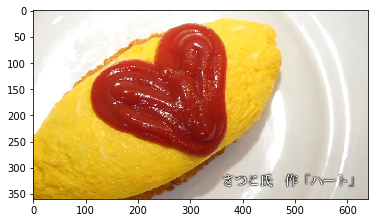

In [7]:
img = _video[N//2]
plt.imshow(img)

In [46]:
import sys
from pathlib import Path
sys.path.append(str(Path.cwd().parents[0]))
import time
import datetime

from models import Darknet
import torch

from chainercv.visualizations import vis_bbox

In [47]:
config_path = "../config/mymodel.cfg"
weights_path = "../result/normal_finetuning_aug_full_strong/35.pkl"
# weights_path = "../weights/yolov3-tiny.weights"
img_size = 416
batchsize = 1
class_path = "../data/coco.names"
conf_thresh = 0.7
nms_thresh = 0.4
img_shape = (img_size, img_size)

In [48]:
classes = ['omulette rice']

In [49]:
model = Darknet(config_path, img_size=img_size)
model_wts = torch.load(weights_path, map_location='cpu')
model.load_state_dict(model_wts)
if torch.cuda.is_available():
    model = model.cuda()

In [53]:
imgs, bboxes, ss, labels = [], [], [], []
for i in tqdm(range(0, len(_video), 5)):
    img = _video[i]
    bbox, max_s = model.predict(img, conf_thresh, nms_thresh)
    
    imgs.append(img.transpose(2, 0, 1))
    ss.append(max_s)
    if len(bbox) != 0:
        bboxes.append([bbox])
        labels.append([0])
    else:
        bboxes.append([])
        labels.append([])
    
    del(img)

100%|██████████| 50/50 [01:00<00:00,  1.22s/it]


In [ ]:
vis_bbox(imgs[0], bboxes[0], labels[0], lsabel_names=classes)
plt.show()

In [14]:
out_path = "/Users/naka/Desktop/out/"
len(imgs)

337

100%|██████████| 337/337 [00:38<00:00,  9.70it/s]


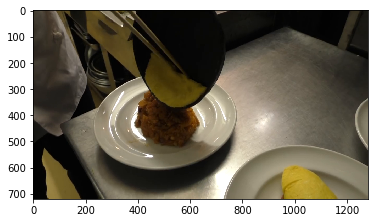

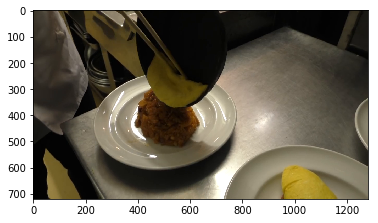

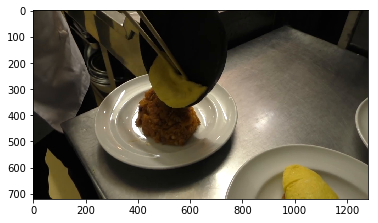

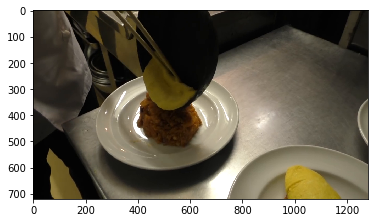

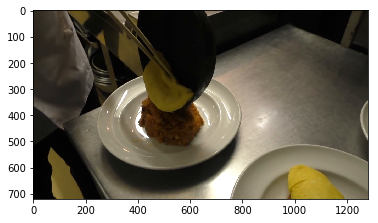

...

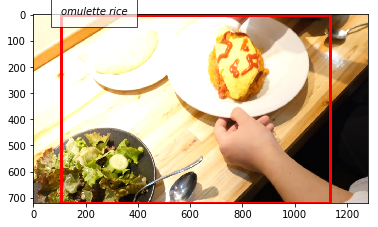

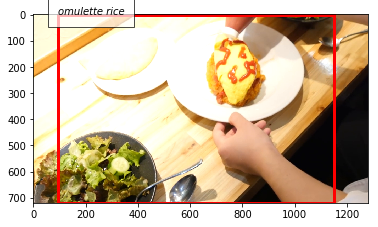

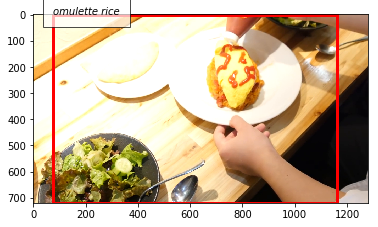

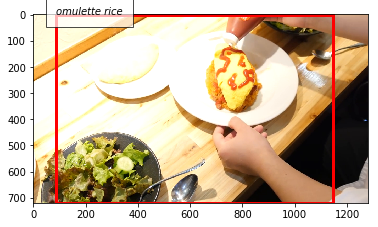

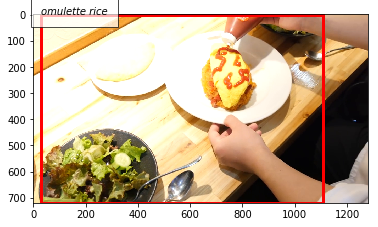

In [16]:
for i in tqdm(range(len(imgs))):
    vis_bbox(imgs[i], bboxes[i], labels[i], label_names=classes)
    plt.savefig(out_path+"{:03d}.jpg".format(i+1))